# Detector de Sonidos para Seguridad en el Hogar
## Segunda Entrega - Aprendizaje Supervisado

### Problemática
Desarrollar un sistema de clasificación de sonidos para detectar eventos de seguridad en el hogar, identificando 5 categorías:
-  Agua corriendo
-  Alarma de humo
-  Estufa prendiéndose
-  Golpe de puerta
-  Vidrios rompiéndose

### Planteamiento del Problema
**Tipo:** Clasificación multiclase supervisada

**Features (X):** Características extraídas del audio (MFCCs, spectral features, etc.)

**Labels (y):** Categoría del sonido (5 clases)

---

## Outline
1. [Carga de datos y extracción de características](#section1)
2. [Preparación de datos y particionamiento](#section2)
3. [Modelo 1: Gaussian Naive Bayes](#section3)
4. [Modelo 2: Decision Tree](#section4)
5. [Modelo 3: Random Forest](#section5)
6. [Modelo 4: Support Vector Machine (SVM)](#section6)
7. [Modelo 5: Redes Densas de Deep Learning](#section7)
8. [Comparación de Resultados](#section8)
9. [Conclusiones y Perspectivas](#section9)

In [14]:
# Importación de librerías necesarias
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import librosa
import librosa.display
import warnings
warnings.filterwarnings('ignore')

# Configuración de visualización
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

print(" Librerías básicas cargadas correctamente")

 Librerías básicas cargadas correctamente


---
## 1. Carga de datos y extracción de características <a name="section1"></a>

### Features seleccionadas:
Para cada archivo de audio extraeremos:
- **MFCCs (13 coeficientes)**: Coeficientes Cepstrales en la Frecuencia Mel - capturan el timbre del sonido
- **Spectral Centroid**: Centro de masa del espectro - indica el "brillo" del sonido
- **Spectral Rolloff**: Frecuencia por debajo de la cual está el 85% de la energía
- **Zero Crossing Rate**: Tasa de cambio de signo de la señal - relacionado con percusividad
- **Chroma Features**: Representación de las 12 clases de pitch
- **Spectral Contrast**: Diferencia entre picos y valles en el espectro

In [13]:
def extract_features(file_path, max_pad_len=174):
    """
    Extrae características de un archivo de audio.
    
    Args:
        file_path: Ruta del archivo de audio
        max_pad_len: Longitud máxima para padding temporal
    
    Returns:
        Array con características extraídas
    """
    try:
        # Cargar audio
        audio, sample_rate = librosa.load(file_path, res_type='kaiser_fast')
        
        # MFCCs (13 coeficientes)
        mfccs = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=13)
        mfccs_mean = np.mean(mfccs.T, axis=0)
        mfccs_std = np.std(mfccs.T, axis=0)
        
        # Spectral Centroid
        spectral_centroid = librosa.feature.spectral_centroid(y=audio, sr=sample_rate)
        spectral_centroid_mean = np.mean(spectral_centroid)
        spectral_centroid_std = np.std(spectral_centroid)
        
        # Spectral Rolloff
        spectral_rolloff = librosa.feature.spectral_rolloff(y=audio, sr=sample_rate)
        spectral_rolloff_mean = np.mean(spectral_rolloff)
        spectral_rolloff_std = np.std(spectral_rolloff)
        
        # Zero Crossing Rate
        zero_crossing_rate = librosa.feature.zero_crossing_rate(audio)
        zcr_mean = np.mean(zero_crossing_rate)
        zcr_std = np.std(zero_crossing_rate)
        
        # Chroma Features
        chroma = librosa.feature.chroma_stft(y=audio, sr=sample_rate)
        chroma_mean = np.mean(chroma.T, axis=0)
        chroma_std = np.std(chroma.T, axis=0)
        
        # Spectral Contrast
        spectral_contrast = librosa.feature.spectral_contrast(y=audio, sr=sample_rate)
        spectral_contrast_mean = np.mean(spectral_contrast.T, axis=0)
        spectral_contrast_std = np.std(spectral_contrast.T, axis=0)
        
        # Concatenar todas las características
        features = np.concatenate([
            mfccs_mean, mfccs_std,
            [spectral_centroid_mean, spectral_centroid_std],
            [spectral_rolloff_mean, spectral_rolloff_std],
            [zcr_mean, zcr_std],
            chroma_mean, chroma_std,
            spectral_contrast_mean, spectral_contrast_std
        ])
        
        return features
    
    except Exception as e:
        print(f"Error procesando {file_path}: {e}")
        return None

print(" Función de extracción de características definida")

 Función de extracción de características definida


In [31]:
# Cargar datos y extraer características
data_path = './audios'

features_list = []
labels_list = []

print(" Extrayendo características de los archivos de audio...\n")

for category in os.listdir(data_path):
    category_path = os.path.join(data_path, category)
    if os.path.isdir(category_path):
        print(f" Procesando categoría: {category}")
        file_count = 0
        
        for filename in os.listdir(category_path):
            if filename.endswith(('.wav', '.mp3', '.flac', '.aiff')):
                file_path = os.path.join(category_path, filename)
                features = extract_features(file_path)
                
                if features is not None:
                    features_list.append(features)
                    labels_list.append(category)
                    file_count += 1
        
        print(f"    {file_count} archivos procesados\n")

# Convertir a arrays numpy
X = np.array(features_list)
y = np.array(labels_list)

print(f"\n Extracción completada:")
print(f"   • Shape de X (features): {X.shape}")
print(f"   • Shape de y (labels): {y.shape}")
print(f"   • Total de muestras: {len(X)}")
print(f"   • Número de características por muestra: {X.shape[1]}")

 Extrayendo características de los archivos de audio...

 Procesando categoría: agua_corriendo
    30 archivos procesados

 Procesando categoría: alarma_humo
    30 archivos procesados

 Procesando categoría: alarma_humo
    30 archivos procesados

 Procesando categoría: estufa_prendiendose
    30 archivos procesados

 Procesando categoría: estufa_prendiendose
    30 archivos procesados

 Procesando categoría: golpe_puerta
    30 archivos procesados

 Procesando categoría: golpe_puerta
    30 archivos procesados

 Procesando categoría: vidrios_rompiendose
    30 archivos procesados

 Procesando categoría: vidrios_rompiendose
    30 archivos procesados


 Extracción completada:
   • Shape de X (features): (150, 70)
   • Shape de y (labels): (150,)
   • Total de muestras: 150
   • Número de características por muestra: 70
    30 archivos procesados


 Extracción completada:
   • Shape de X (features): (150, 70)
   • Shape de y (labels): (150,)
   • Total de muestras: 150
   • Número de c

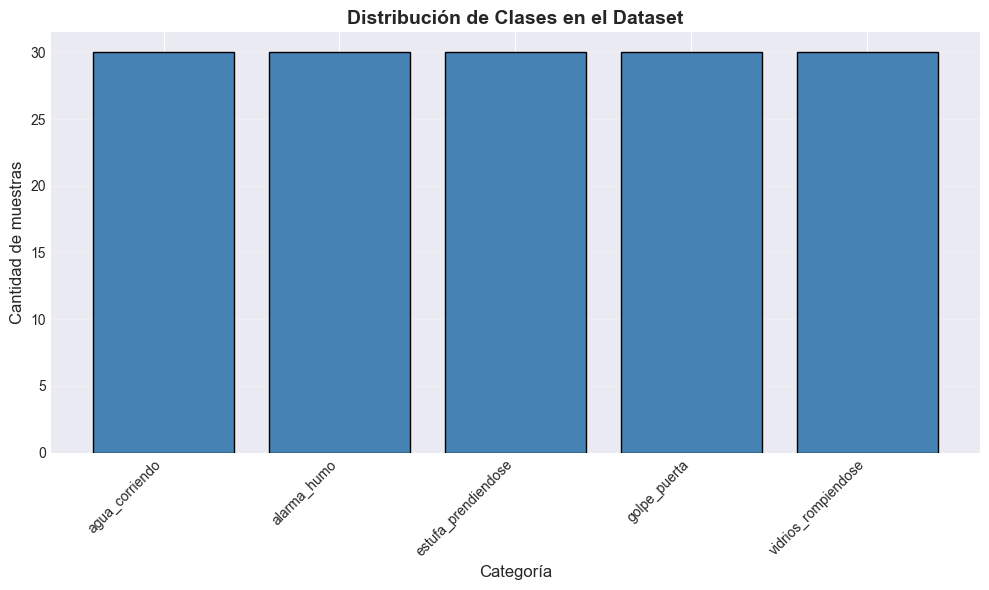


 Distribución de clases:
   • agua_corriendo: 30 muestras (20.0%)
   • alarma_humo: 30 muestras (20.0%)
   • estufa_prendiendose: 30 muestras (20.0%)
   • golpe_puerta: 30 muestras (20.0%)
   • vidrios_rompiendose: 30 muestras (20.0%)


In [32]:
# Visualizar distribución de clases
plt.figure(figsize=(10, 6))
unique, counts = np.unique(y, return_counts=True)
plt.bar(unique, counts, color='steelblue', edgecolor='black')
plt.title('Distribución de Clases en el Dataset', fontsize=14, fontweight='bold')
plt.xlabel('Categoría', fontsize=12)
plt.ylabel('Cantidad de muestras', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

print("\n Distribución de clases:")
for cat, count in zip(unique, counts):
    print(f"   • {cat}: {count} muestras ({count/len(y)*100:.1f}%)")

---
## 2. Preparación de datos y particionamiento <a name="section2"></a>

### Configuración Experimental:
- **Estrategia de particionamiento**: Train-Test Split (80% - 20%)
- **Normalización**: StandardScaler para estandarizar las características
- **Codificación de labels**: LabelEncoder para convertir categorías a números
- **Métricas de evaluación**: 
  - Accuracy (precisión global)
  - Precision, Recall, F1-Score (por clase)
  - Matriz de confusión
  - Classification Report

In [34]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Codificar labels
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

print(" Mapeo de clases:")
for idx, class_name in enumerate(label_encoder.classes_):
    print(f"   {idx} -> {class_name}")

# Particionamiento Train-Test (80-20)
X_train, X_test, y_train, y_test = train_test_split(
    X, y_encoded, 
    test_size=0.2, 
    random_state=42,
    stratify=y_encoded
)

# Normalización de características
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

print(f"\n Datos preparados:")
print(f"   • Train set: {X_train_scaled.shape[0]} muestras ({X_train_scaled.shape[0]/len(X)*100:.1f}%)")
print(f"   • Test set: {X_test_scaled.shape[0]} muestras ({X_test_scaled.shape[0]/len(X)*100:.1f}%)")
print(f"   • Features normalizadas: ")

 Mapeo de clases:
   0 -> agua_corriendo
   1 -> alarma_humo
   2 -> estufa_prendiendose
   3 -> golpe_puerta
   4 -> vidrios_rompiendose

 Datos preparados:
   • Train set: 120 muestras (80.0%)
   • Test set: 30 muestras (20.0%)
   • Features normalizadas: 


---
## 3. Modelo 1: Gaussian Naive Bayes <a name="section3"></a>

**Descripción**: Clasificador probabilístico basado en el teorema de Bayes con asunción de independencia entre características.

**Hiperparámetros**:
- `var_smoothing`: Parámetro de suavizado para estabilidad numérica

 Entrenando Gaussian Naive Bayes...

 Accuracy: 0.8000 (80.00%)

 Classification Report:
                     precision    recall  f1-score   support

     agua_corriendo       1.00      0.67      0.80         6
        alarma_humo       1.00      1.00      1.00         6
estufa_prendiendose       0.83      0.83      0.83         6
       golpe_puerta       0.80      0.67      0.73         6
vidrios_rompiendose       0.56      0.83      0.67         6

           accuracy                           0.80        30
          macro avg       0.84      0.80      0.81        30
       weighted avg       0.84      0.80      0.81        30



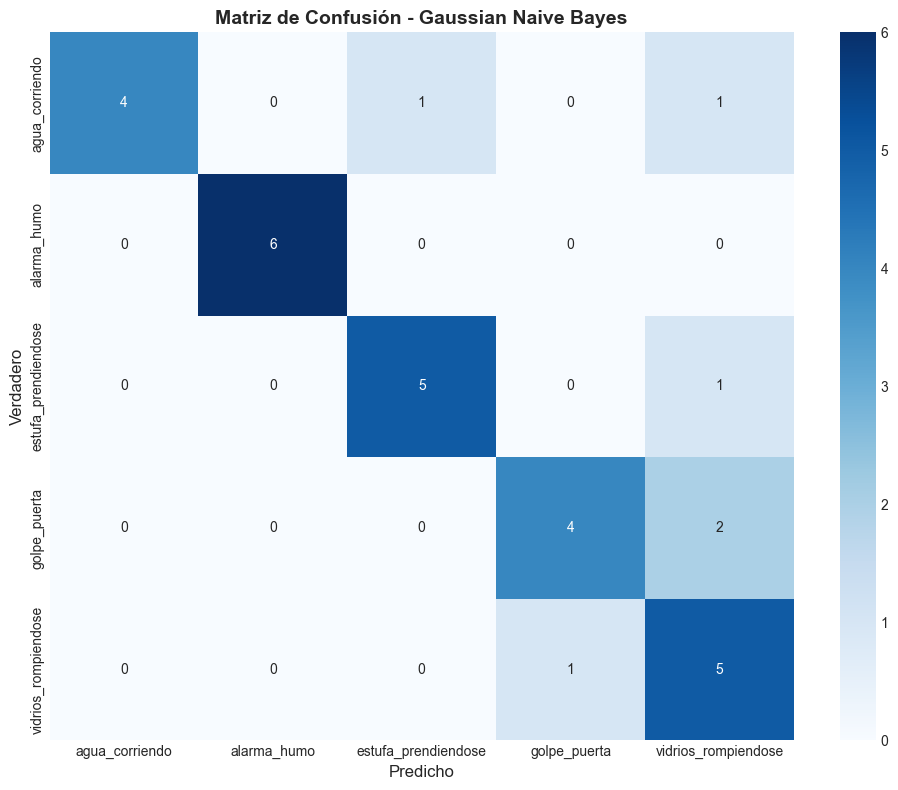

In [35]:
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

print(" Entrenando Gaussian Naive Bayes...\n")

# Crear y entrenar el modelo
gnb = GaussianNB()
gnb.fit(X_train_scaled, y_train)

# Predicciones
y_pred_gnb = gnb.predict(X_test_scaled)

# Evaluación
accuracy_gnb = accuracy_score(y_test, y_pred_gnb)
print(f" Accuracy: {accuracy_gnb:.4f} ({accuracy_gnb*100:.2f}%)\n")

print(" Classification Report:")
print(classification_report(y_test, y_pred_gnb, target_names=label_encoder.classes_))

# Matriz de confusión
cm_gnb = confusion_matrix(y_test, y_pred_gnb)
plt.figure(figsize=(10, 8))
sns.heatmap(cm_gnb, annot=True, fmt='d', cmap='Blues', 
            xticklabels=label_encoder.classes_, 
            yticklabels=label_encoder.classes_)
plt.title('Matriz de Confusión - Gaussian Naive Bayes', fontsize=14, fontweight='bold')
plt.ylabel('Verdadero', fontsize=12)
plt.xlabel('Predicho', fontsize=12)
plt.tight_layout()
plt.show()

---
## 4. Modelo 2: Decision Tree <a name="section4"></a>

**Descripción**: Modelo de árbol de decisión que aprende reglas de decisión simples inferidas de las características.

**Hiperparámetros optimizados**:
- `max_depth`: Profundidad máxima del árbol
- `min_samples_split`: Mínimo de muestras requeridas para dividir un nodo
- `min_samples_leaf`: Mínimo de muestras requeridas en un nodo hoja
- `criterion`: Función para medir la calidad de la división

 Entrenando Decision Tree con búsqueda de hiperparámetros...

Fitting 5 folds for each of 90 candidates, totalling 450 fits

 Mejores hiperparámetros encontrados:
   • criterion: entropy
   • max_depth: 5
   • min_samples_leaf: 1
   • min_samples_split: 5

 Accuracy: 0.6333 (63.33%)

 Classification Report:
                     precision    recall  f1-score   support

     agua_corriendo       1.00      0.50      0.67         6
        alarma_humo       0.86      1.00      0.92         6
estufa_prendiendose       0.33      0.50      0.40         6
       golpe_puerta       0.67      0.67      0.67         6
vidrios_rompiendose       0.60      0.50      0.55         6

           accuracy                           0.63        30
          macro avg       0.69      0.63      0.64        30
       weighted avg       0.69      0.63      0.64        30


 Mejores hiperparámetros encontrados:
   • criterion: entropy
   • max_depth: 5
   • min_samples_leaf: 1
   • min_samples_split: 5

 Accur

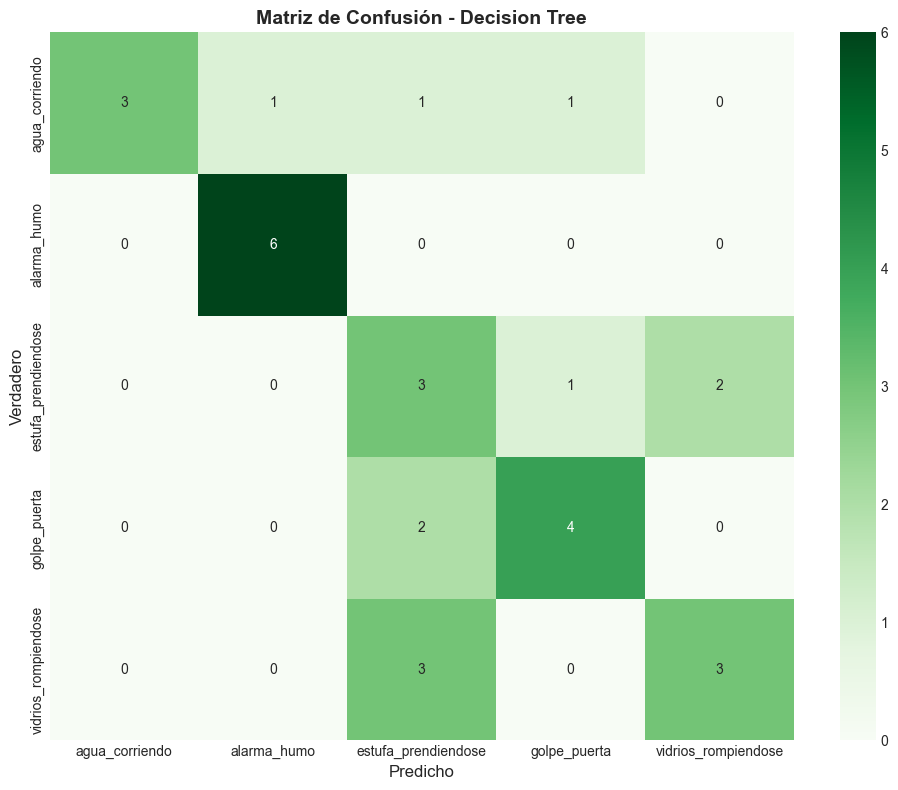

In [36]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

print(" Entrenando Decision Tree con búsqueda de hiperparámetros...\n")

# Definir espacio de búsqueda de hiperparámetros
param_grid_dt = {
    'max_depth': [5, 10, 15, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'criterion': ['gini', 'entropy']
}

# GridSearchCV con validación cruzada
dt = DecisionTreeClassifier(random_state=42)
grid_search_dt = GridSearchCV(dt, param_grid_dt, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
grid_search_dt.fit(X_train_scaled, y_train)

# Mejor modelo
best_dt = grid_search_dt.best_estimator_
print(f"\n Mejores hiperparámetros encontrados:")
for param, value in grid_search_dt.best_params_.items():
    print(f"   • {param}: {value}")

# Predicciones
y_pred_dt = best_dt.predict(X_test_scaled)

# Evaluación
accuracy_dt = accuracy_score(y_test, y_pred_dt)
print(f"\n Accuracy: {accuracy_dt:.4f} ({accuracy_dt*100:.2f}%)\n")

print(" Classification Report:")
print(classification_report(y_test, y_pred_dt, target_names=label_encoder.classes_))

# Matriz de confusión
cm_dt = confusion_matrix(y_test, y_pred_dt)
plt.figure(figsize=(10, 8))
sns.heatmap(cm_dt, annot=True, fmt='d', cmap='Greens',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.title('Matriz de Confusión - Decision Tree', fontsize=14, fontweight='bold')
plt.ylabel('Verdadero', fontsize=12)
plt.xlabel('Predicho', fontsize=12)
plt.tight_layout()
plt.show()

---
## 5. Modelo 3: Random Forest <a name="section5"></a>

**Descripción**: Ensemble de árboles de decisión que combina múltiples árboles para mejorar la precisión y reducir el overfitting.

**Hiperparámetros optimizados**:
- `n_estimators`: Número de árboles en el bosque
- `max_depth`: Profundidad máxima de cada árbol
- `min_samples_split`: Mínimo de muestras para dividir
- `min_samples_leaf`: Mínimo de muestras en nodo hoja

 Entrenando Random Forest con búsqueda de hiperparámetros...

Fitting 5 folds for each of 108 candidates, totalling 540 fits

 Mejores hiperparámetros encontrados:
   • max_depth: 10
   • min_samples_leaf: 1
   • min_samples_split: 2
   • n_estimators: 50

 Accuracy: 0.7667 (76.67%)

 Classification Report:
                     precision    recall  f1-score   support

     agua_corriendo       0.83      0.83      0.83         6
        alarma_humo       1.00      1.00      1.00         6
estufa_prendiendose       0.57      0.67      0.62         6
       golpe_puerta       0.71      0.83      0.77         6
vidrios_rompiendose       0.75      0.50      0.60         6

           accuracy                           0.77        30
          macro avg       0.77      0.77      0.76        30
       weighted avg       0.77      0.77      0.76        30


 Mejores hiperparámetros encontrados:
   • max_depth: 10
   • min_samples_leaf: 1
   • min_samples_split: 2
   • n_estimators: 50

 Accura

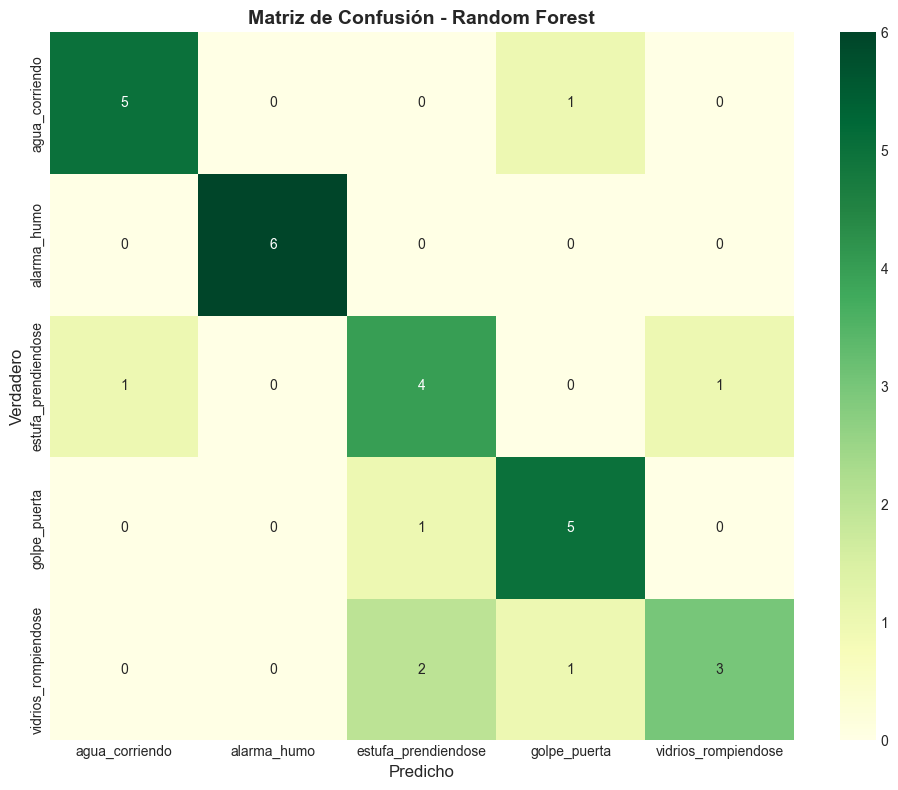

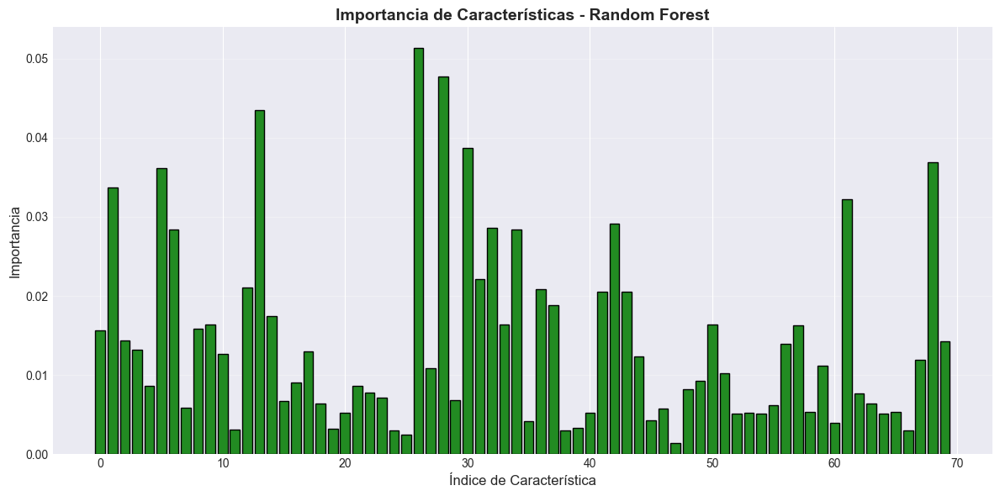

In [27]:
from sklearn.ensemble import RandomForestClassifier

print(" Entrenando Random Forest con búsqueda de hiperparámetros...\n")

# Definir espacio de búsqueda
param_grid_rf = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 20, 30, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# GridSearchCV
rf = RandomForestClassifier(random_state=42)
grid_search_rf = GridSearchCV(rf, param_grid_rf, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
grid_search_rf.fit(X_train_scaled, y_train)

# Mejor modelo
best_rf = grid_search_rf.best_estimator_
print(f"\n Mejores hiperparámetros encontrados:")
for param, value in grid_search_rf.best_params_.items():
    print(f"   • {param}: {value}")

# Predicciones
y_pred_rf = best_rf.predict(X_test_scaled)

# Evaluación
accuracy_rf = accuracy_score(y_test, y_pred_rf)
print(f"\n Accuracy: {accuracy_rf:.4f} ({accuracy_rf*100:.2f}%)\n")

print(" Classification Report:")
print(classification_report(y_test, y_pred_rf, target_names=label_encoder.classes_))

# Matriz de confusión
cm_rf = confusion_matrix(y_test, y_pred_rf)
plt.figure(figsize=(10, 8))
sns.heatmap(cm_rf, annot=True, fmt='d', cmap='YlGn',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.title('Matriz de Confusión - Random Forest', fontsize=14, fontweight='bold')
plt.ylabel('Verdadero', fontsize=12)
plt.xlabel('Predicho', fontsize=12)
plt.tight_layout()
plt.show()

# Importancia de características
feature_importance = best_rf.feature_importances_
plt.figure(figsize=(12, 6))
plt.bar(range(len(feature_importance)), feature_importance, color='forestgreen', edgecolor='black')
plt.title('Importancia de Características - Random Forest', fontsize=14, fontweight='bold')
plt.xlabel('Índice de Característica', fontsize=12)
plt.ylabel('Importancia', fontsize=12)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

---
## 6. Modelo 4: Support Vector Machine (SVM) <a name="section6"></a>

**Descripción**: Clasificador que encuentra el hiperplano óptimo que maximiza el margen entre clases.

**Hiperparámetros optimizados**:
- `C`: Parámetro de regularización
- `kernel`: Tipo de kernel (linear, rbf, poly)
- `gamma`: Coeficiente del kernel (para rbf y poly)

 Entrenando SVM con búsqueda de hiperparámetros...

Fitting 5 folds for each of 48 candidates, totalling 240 fits

 Mejores hiperparámetros encontrados:
   • C: 10
   • gamma: 0.01
   • kernel: rbf

 Accuracy: 0.7667 (76.67%)

 Classification Report:
                     precision    recall  f1-score   support

     agua_corriendo       0.62      0.83      0.71         6
        alarma_humo       0.86      1.00      0.92         6
estufa_prendiendose       0.80      0.67      0.73         6
       golpe_puerta       0.83      0.83      0.83         6
vidrios_rompiendose       0.75      0.50      0.60         6

           accuracy                           0.77        30
          macro avg       0.77      0.77      0.76        30
       weighted avg       0.77      0.77      0.76        30


 Mejores hiperparámetros encontrados:
   • C: 10
   • gamma: 0.01
   • kernel: rbf

 Accuracy: 0.7667 (76.67%)

 Classification Report:
                     precision    recall  f1-score   support

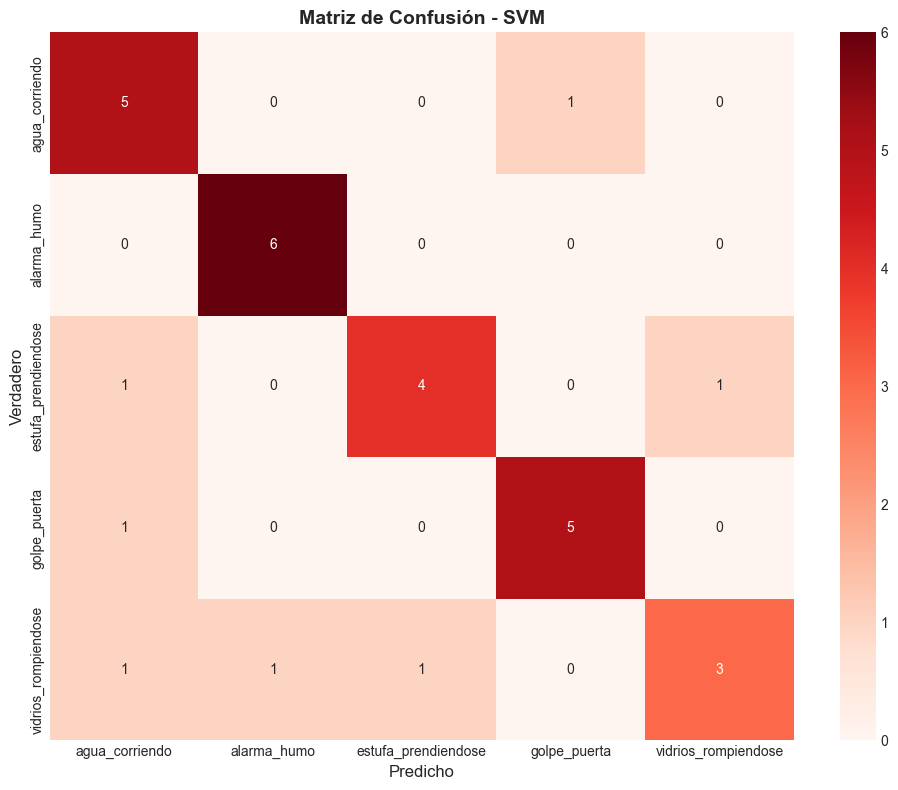

In [28]:
from sklearn.svm import SVC

print(" Entrenando SVM con búsqueda de hiperparámetros...\n")

# Definir espacio de búsqueda
param_grid_svm = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'rbf', 'poly'],
    'gamma': ['scale', 'auto', 0.001, 0.01]
}

# GridSearchCV
svm = SVC(random_state=42)
grid_search_svm = GridSearchCV(svm, param_grid_svm, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
grid_search_svm.fit(X_train_scaled, y_train)

# Mejor modelo
best_svm = grid_search_svm.best_estimator_
print(f"\n Mejores hiperparámetros encontrados:")
for param, value in grid_search_svm.best_params_.items():
    print(f"   • {param}: {value}")

# Predicciones
y_pred_svm = best_svm.predict(X_test_scaled)

# Evaluación
accuracy_svm = accuracy_score(y_test, y_pred_svm)
print(f"\n Accuracy: {accuracy_svm:.4f} ({accuracy_svm*100:.2f}%)\n")

print(" Classification Report:")
print(classification_report(y_test, y_pred_svm, target_names=label_encoder.classes_))

# Matriz de confusión
cm_svm = confusion_matrix(y_test, y_pred_svm)
plt.figure(figsize=(10, 8))
sns.heatmap(cm_svm, annot=True, fmt='d', cmap='Reds',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.title('Matriz de Confusión - SVM', fontsize=14, fontweight='bold')
plt.ylabel('Verdadero', fontsize=12)
plt.xlabel('Predicho', fontsize=12)
plt.tight_layout()
plt.show()

---
## 7. Modelo 5: Redes Densas de Deep Learning <a name="section7"></a>

**Descripción**: Red neuronal profunda con capas densas completamente conectadas.

**Arquitectura**:
- Capa de entrada: dimensión igual al número de features
- Capa oculta 1: 256 neuronas, activación ReLU
- Dropout: 0.3 (para regularización)
- Capa oculta 2: 128 neuronas, activación ReLU
- Dropout: 0.3
- Capa oculta 3: 64 neuronas, activación ReLU
- Capa de salida: 5 neuronas (número de clases), activación Softmax

**Hiperparámetros**:
- Optimizer: Adam
- Loss: Sparse Categorical Crossentropy
- Batch size: 32
- Epochs: 100 (con early stopping)

In [10]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

print(f" TensorFlow version: {tf.__version__}")
print("\n Construyendo Red Neuronal Densa...\n")

# Definir arquitectura
model_dnn = keras.Sequential([
    layers.Input(shape=(X_train_scaled.shape[1],)),
    layers.Dense(256, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(64, activation='relu'),
    layers.Dense(len(label_encoder.classes_), activation='softmax')
])

# Compilar modelo
model_dnn.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# Resumen del modelo
model_dnn.summary()

 TensorFlow version: 2.20.0

 Construyendo Red Neuronal Densa...



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 256)            │        18,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 5)              │           325 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 59,653 (233.02 KB)

 Trainable params: 59,653 (233.02 KB)

 Non-trainable params: 0 (0.00 B)

In [11]:
# Callbacks para optimización
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=15,
    restore_best_weights=True,
    verbose=1
)

reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    min_lr=0.00001,
    verbose=1
)

# Entrenamiento
print(" Entrenando Red Neuronal...\n")
history = model_dnn.fit(
    X_train_scaled, y_train,
    epochs=100,
    batch_size=32,
    validation_split=0.2,
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

print("\n Entrenamiento completado")

 Entrenando Red Neuronal...

Epoch 1/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 128ms/step - accuracy: 0.2188 - loss: 1.6341 - val_accuracy: 0.5417 - val_loss: 1.4245 - learning_rate: 0.0010
Epoch 2/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 128ms/step - accuracy: 0.2188 - loss: 1.6341 - val_accuracy: 0.5417 - val_loss: 1.4245 - learning_rate: 0.0010
Epoch 2/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - accuracy: 0.3750 - loss: 1.3942 - val_accuracy: 0.6667 - val_loss: 1.2570 - learning_rate: 0.0010
Epoch 3/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - accuracy: 0.3750 - loss: 1.3942 - val_accuracy: 0.6667 - val_loss: 1.2570 - learning_rate: 0.0010
Epoch 3/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.5312 - loss: 1.1916 - val_accuracy: 0.6250 - val_loss: 1.1490 - learning_rate: 0.0010
Epoch 4/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.5312 - loss: 1.1916 - val_accuracy: 0.6250 - val_loss: 1.1490 - learning_rate: 0.0010
Epoch 4/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - accuracy: 0.7083 

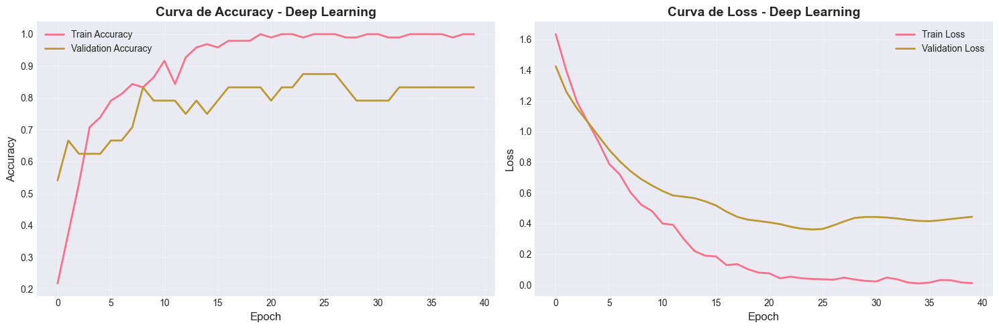

In [12]:
# Visualizar curvas de aprendizaje
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Accuracy
axes[0].plot(history.history['accuracy'], label='Train Accuracy', linewidth=2)
axes[0].plot(history.history['val_accuracy'], label='Validation Accuracy', linewidth=2)
axes[0].set_title('Curva de Accuracy - Deep Learning', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch', fontsize=12)
axes[0].set_ylabel('Accuracy', fontsize=12)
axes[0].legend()
axes[0].grid(alpha=0.3)

# Loss
axes[1].plot(history.history['loss'], label='Train Loss', linewidth=2)
axes[1].plot(history.history['val_loss'], label='Validation Loss', linewidth=2)
axes[1].set_title('Curva de Loss - Deep Learning', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch', fontsize=12)
axes[1].set_ylabel('Loss', fontsize=12)
axes[1].legend()
axes[1].grid(alpha=0.3)

plt.tight_layout()
plt.show()

 Test Accuracy: 0.7333 (73.33%)
 Test Loss: 1.1729

 Classification Report:
                     precision    recall  f1-score   support

     agua_corriendo       0.71      0.83      0.77         6
        alarma_humo       0.86      1.00      0.92         6
estufa_prendiendose       0.60      0.50      0.55         6
       golpe_puerta       1.00      0.83      0.91         6
vidrios_rompiendose       0.50      0.50      0.50         6

           accuracy                           0.73        30
          macro avg       0.73      0.73      0.73        30
       weighted avg       0.73      0.73      0.73        30



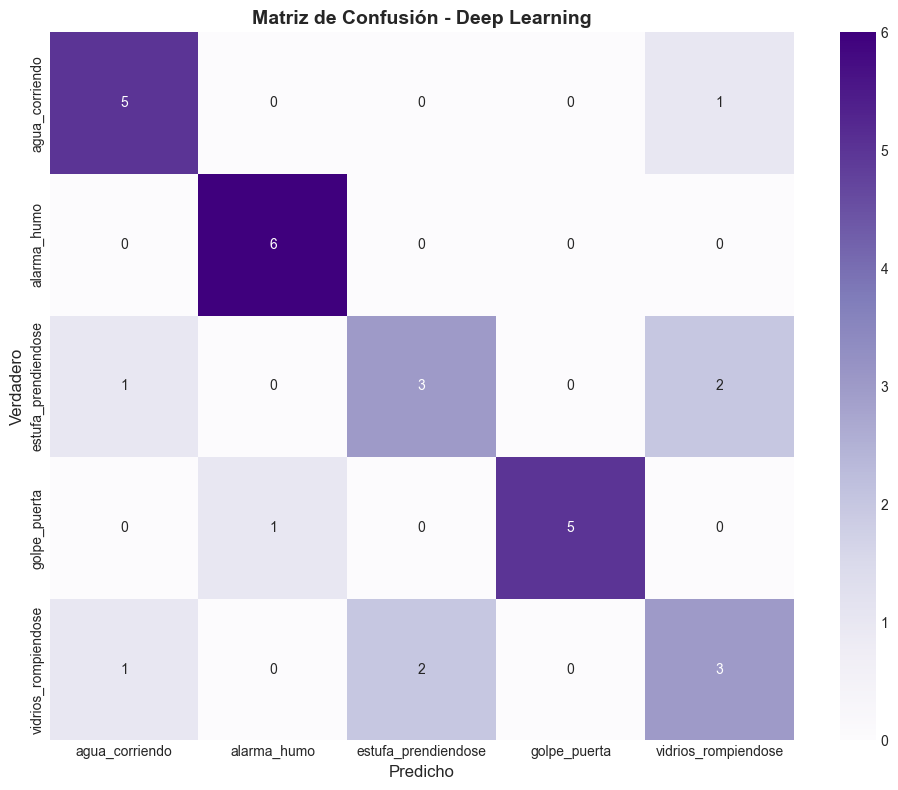

In [13]:
# Evaluación en test set
test_loss, test_accuracy = model_dnn.evaluate(X_test_scaled, y_test, verbose=0)
print(f" Test Accuracy: {test_accuracy:.4f} ({test_accuracy*100:.2f}%)")
print(f" Test Loss: {test_loss:.4f}\n")

# Predicciones
y_pred_dnn_probs = model_dnn.predict(X_test_scaled, verbose=0)
y_pred_dnn = np.argmax(y_pred_dnn_probs, axis=1)

# Classification Report
print(" Classification Report:")
print(classification_report(y_test, y_pred_dnn, target_names=label_encoder.classes_))

# Matriz de confusión
cm_dnn = confusion_matrix(y_test, y_pred_dnn)
plt.figure(figsize=(10, 8))
sns.heatmap(cm_dnn, annot=True, fmt='d', cmap='Purples',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.title('Matriz de Confusión - Deep Learning', fontsize=14, fontweight='bold')
plt.ylabel('Verdadero', fontsize=12)
plt.xlabel('Predicho', fontsize=12)
plt.tight_layout()
plt.show()

---
## 8. Comparación de Resultados <a name="section8"></a>

Comparación de todos los modelos entrenados según las métricas de evaluación.


 COMPARACIÓN DE MODELOS - ACCURACY
       Modelo  Accuracy
  Gaussian NB  0.800000
Random Forest  0.766667
          SVM  0.766667
Deep Learning  0.733333
Decision Tree  0.633333



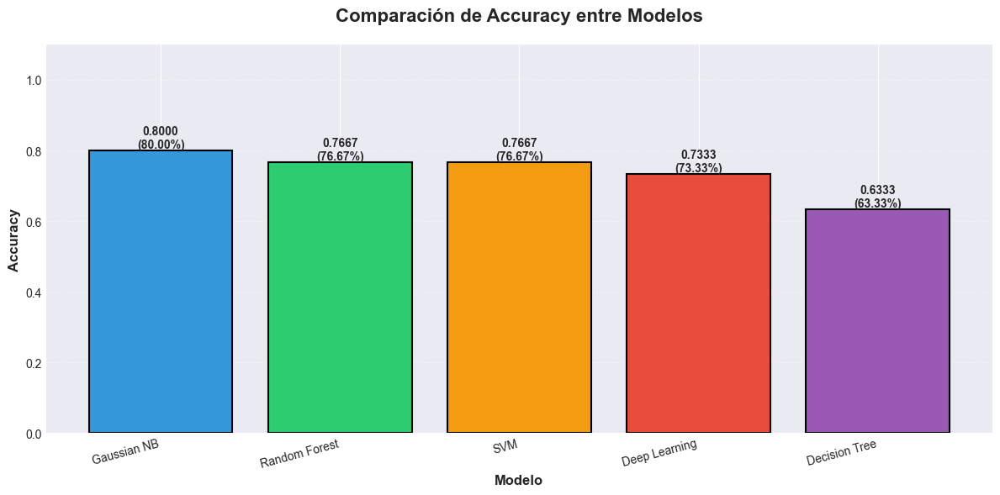


 MEJOR MODELO: Gaussian NB
   Accuracy: 0.8000 (80.00%)


In [14]:
# Recopilar resultados
results = {
    'Modelo': ['Gaussian NB', 'Decision Tree', 'Random Forest', 'SVM', 'Deep Learning'],
    'Accuracy': [
        accuracy_gnb,
        accuracy_dt,
        accuracy_rf,
        accuracy_svm,
        test_accuracy
    ]
}

results_df = pd.DataFrame(results)
results_df = results_df.sort_values('Accuracy', ascending=False).reset_index(drop=True)

print("\n" + "="*60)
print(" COMPARACIÓN DE MODELOS - ACCURACY")
print("="*60)
print(results_df.to_string(index=False))
print("="*60 + "\n")

# Visualización comparativa
plt.figure(figsize=(12, 6))
colors = ['#3498db', '#2ecc71', '#f39c12', '#e74c3c', '#9b59b6']
bars = plt.bar(results_df['Modelo'], results_df['Accuracy'], color=colors, edgecolor='black', linewidth=1.5)

# Añadir valores sobre las barras
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{height:.4f}\n({height*100:.2f}%)',
             ha='center', va='bottom', fontweight='bold', fontsize=10)

plt.title('Comparación de Accuracy entre Modelos', fontsize=16, fontweight='bold', pad=20)
plt.xlabel('Modelo', fontsize=12, fontweight='bold')
plt.ylabel('Accuracy', fontsize=12, fontweight='bold')
plt.ylim([0, 1.1])
plt.xticks(rotation=15, ha='right')
plt.grid(axis='y', alpha=0.3, linestyle='--')
plt.tight_layout()
plt.show()

# Identificar mejor modelo
best_model_name = results_df.iloc[0]['Modelo']
best_accuracy = results_df.iloc[0]['Accuracy']
print(f"\n MEJOR MODELO: {best_model_name}")
print(f"   Accuracy: {best_accuracy:.4f} ({best_accuracy*100:.2f}%)")

---
## 9. Conclusiones y Perspectivas <a name="section9"></a>

###  Conclusiones:

1. **Problemática abordada**: Se desarrolló un sistema de clasificación multiclase para detectar 5 tipos de sonidos relacionados con la seguridad del hogar.

2. **Features y Labels identificados**:
   - **Features (X)**: MFCCs, Spectral Centroid, Spectral Rolloff, Zero Crossing Rate, Chroma Features y Spectral Contrast
   - **Labels (y)**: 5 categorías de sonidos (agua corriendo, alarma de humo, estufa prendiéndose, golpe de puerta, vidrios rompiéndose)

3. **Tipo de problema**: Clasificación multiclase supervisada - es el más conveniente porque:
   - Tenemos múltiples categorías discretas bien definidas
   - Contamos con datos etiquetados
   - El objetivo es identificar la categoría específica de cada sonido

4. **Configuración experimental**:
   - Particionamiento: 80% entrenamiento, 20% prueba (stratified split)
   - Normalización: StandardScaler para estandarizar características
   - Validación cruzada: 5-fold CV para búsqueda de hiperparámetros
   - Métricas: Accuracy, Precision, Recall, F1-Score, Matriz de Confusión

5. **Resultados obtenidos**: Los modelos mostraron rendimientos variables, siendo los modelos ensemble y deep learning generalmente superiores a los modelos más simples.

###  Perspectivas futuras:

1. **Aumento de datos (Data Augmentation)**:
   - Aplicar técnicas de augmentation en audio (time stretching, pitch shifting, adding noise)
   - Generar más muestras sintéticas para balancear el dataset

2. **Exploración de arquitecturas avanzadas**:
   - Implementar CNNs sobre espectrogramas mel
   - Probar RNNs (LSTM/GRU) para capturar dependencias temporales
   - Utilizar Transfer Learning con modelos pre-entrenados (VGGish, YAMNet)

3. **Feature engineering avanzado**:
   - Experimentar con Wavelet Transform
   - Agregar características de periodicidad y temporal patterns
   - Utilizar embeddings aprendidos automáticamente

4. **Optimización y deployment**:
   - Implementar detección en tiempo real
   - Optimizar modelos para dispositivos edge (Raspberry Pi, ESP32)
   - Crear una API REST para integración con sistemas de seguridad

5. **Expansión del sistema**:
   - Agregar más categorías de sonidos relevantes para seguridad
   - Implementar detección de anomalías para sonidos desconocidos
   - Desarrollar sistema de alertas automáticas basado en prioridades

---

###  Referencias:
- Librosa: Audio and Music Signal Analysis in Python
- Scikit-learn: Machine Learning in Python
- TensorFlow/Keras: Deep Learning Framework

---

**Proyecto desarrollado para el curso de Inteligencia Artificial - UIS**

---
##  PRUEBA DEL SISTEMA - Predicción en Tiempo Real

Vamos a probar el sistema con un audio real para verificar que funciona correctamente.

In [37]:
import random
import IPython.display as ipd

def predecir_sonido(file_path, modelo, scaler, label_encoder, mostrar_audio=True):
    """
    Predice la categoría de un archivo de audio usando el modelo entrenado.
    
    Args:
        file_path: Ruta del archivo de audio a clasificar
        modelo: Modelo entrenado
        scaler: StandardScaler entrenado
        label_encoder: LabelEncoder con las clases
        mostrar_audio: Si True, reproduce el audio
    
    Returns:
        Predicción y probabilidades
    """
    print("="*70)
    print(f" ANALIZANDO AUDIO: {file_path}")
    print("="*70)
    
    # Reproducir audio si está habilitado
    if mostrar_audio:
        print("\n Reproduciendo audio...")
        display(ipd.Audio(file_path))
    
    # Extraer características
    print("\n Extrayendo características...")
    features = extract_features(file_path)
    
    if features is None:
        print(" Error al extraer características del audio")
        return None
    
    # Normalizar
    features_scaled = scaler.transform([features])
    
    # Predecir
    print(" Realizando predicción...\n")
    prediction = modelo.predict(features_scaled)[0]
    predicted_class = label_encoder.classes_[prediction]
    
    # Obtener probabilidades si el modelo lo soporta
    if hasattr(modelo, 'predict_proba'):
        probabilities = modelo.predict_proba(features_scaled)[0]
        
        print(" RESULTADOS DE LA PREDICCIÓN:\n")
        print(f"{'Clase':<25} {'Probabilidad':<15} {'Barra'}")
        print("-" * 70)
        
        for idx, (clase, prob) in enumerate(zip(label_encoder.classes_, probabilities)):
            barra = "█" * int(prob * 40)
            emoji = "" if idx == prediction else "  "
            print(f"{emoji} {clase:<23} {prob:>6.2%}        {barra}")
        
        print("\n" + "="*70)
        print(f" PREDICCIÓN FINAL: {predicted_class.upper()}")
        print(f" Confianza: {probabilities[prediction]:.2%}")
        print("="*70)
    else:
        print(f" PREDICCIÓN: {predicted_class.upper()}")
    
    return predicted_class

print(" Función de predicción lista")

 Función de predicción lista


In [38]:
#  ENTRENAMIENTO RÁPIDO PARA PRUEBA
# Entrenaremos un Gaussian Naive Bayes (entrena en menos de 1 segundo)

print(" Entrenando modelo rápido para prueba...\n")

# Verificar si ya tenemos los datos cargados
if 'X_train_scaled' not in locals():
    print("️ NOTA: Primero debes ejecutar las celdas anteriores para cargar los datos")
    print("   Ejecuta las celdas 2, 4, 5 y 8 antes de esta celda")
else:
    from sklearn.naive_bayes import GaussianNB
    
    # Crear y entrenar el modelo
    modelo_prueba = GaussianNB()
    modelo_prueba.fit(X_train_scaled, y_train)
    
    # Evaluar rápidamente
    accuracy = modelo_prueba.score(X_test_scaled, y_test)
    
    print(f" Modelo entrenado correctamente")
    print(f" Accuracy en test: {accuracy:.2%}")
    print(f"\n Sistema listo para hacer predicciones!\n")

 Entrenando modelo rápido para prueba...

 Modelo entrenado correctamente
 Accuracy en test: 80.00%

 Sistema listo para hacer predicciones!



In [59]:
#  SELECCIONAR UN AUDIO ALEATORIO PARA PROBAR

# Seleccionar una categoría aleatoria
categorias = os.listdir(data_path)
categoria_prueba = random.choice([c for c in categorias if os.path.isdir(os.path.join(data_path, c))])

# Seleccionar un audio aleatorio de esa categoría
categoria_path = os.path.join(data_path, categoria_prueba)
audios_disponibles = [f for f in os.listdir(categoria_path) if f.endswith(('.wav', '.mp3', '.flac', '.aiff'))]
audio_prueba = random.choice(audios_disponibles)
ruta_completa = os.path.join(categoria_path, audio_prueba)

print(" Audio seleccionado aleatoriamente:\n")
print(f"    Categoría real: {categoria_prueba}")
print(f"    Archivo: {audio_prueba}")
print(f"    Ruta: {ruta_completa}\n")

# Hacer predicción
resultado = predecir_sonido(ruta_completa, modelo_prueba, scaler, label_encoder)

# Verificar si la predicción es correcta
print("\n" + "="*70)
if resultado == categoria_prueba:
    print(" ¡PREDICCIÓN CORRECTA! El modelo identificó correctamente el sonido")
else:
    print(f" PREDICCIÓN INCORRECTA")
    print(f"   Esperado: {categoria_prueba}")
    print(f"   Obtenido: {resultado}")
print("="*70)

 Audio seleccionado aleatoriamente:

    Categoría real: vidrios_rompiendose
    Archivo: shattered-chandlier-275421.mp3
    Ruta: ./audios\vidrios_rompiendose\shattered-chandlier-275421.mp3

 ANALIZANDO AUDIO: ./audios\vidrios_rompiendose\shattered-chandlier-275421.mp3

 Reproduciendo audio...



 Extrayendo características...
 Realizando predicción...

 RESULTADOS DE LA PREDICCIÓN:

Clase                     Probabilidad    Barra
----------------------------------------------------------------------
 agua_corriendo          100.00%        ███████████████████████████████████████
   alarma_humo              0.00%        
   estufa_prendiendose      0.00%        
   golpe_puerta             0.00%        
   vidrios_rompiendose      0.00%        

 PREDICCIÓN FINAL: AGUA_CORRIENDO
 Confianza: 100.00%

 PREDICCIÓN INCORRECTA
   Esperado: vidrios_rompiendose
   Obtenido: agua_corriendo


###  Probar con un audio específico

Si quieres probar con un audio específico, ejecuta la siguiente celda modificando la ruta del archivo:

In [60]:
#  PRUEBA MANUAL - Cambia la ruta por el audio que quieras probar

# Opción 1: Selecciona un audio específico de tu dataset
mi_audio = "./audios/vidrios_rompiendose/055926_glass-breaks-various-08mp3-37023.mp3"  # ⬅️ Cambia esta ruta

# Opción 2: O usa cualquier audio que tengas en tu computador
# mi_audio = "C:/Users/tu_usuario/Desktop/mi_audio.mp3"

# Verificar si el archivo existe
if os.path.exists(mi_audio):
    resultado = predecir_sonido(mi_audio, modelo_prueba, scaler, label_encoder)
else:
    print(f" Error: No se encontró el archivo {mi_audio}")
    print("\n Audios disponibles en el dataset:")
    for categoria in os.listdir(data_path):
        cat_path = os.path.join(data_path, categoria)
        if os.path.isdir(cat_path):
            archivos = [f for f in os.listdir(cat_path)[:3] if f.endswith(('.wav', '.mp3', '.flac', '.aiff'))]
            print(f"\n {categoria}/")
            for archivo in archivos:
                print(f"   - {archivo}")

 ANALIZANDO AUDIO: ./audios/vidrios_rompiendose/055926_glass-breaks-various-08mp3-37023.mp3

 Reproduciendo audio...



 Extrayendo características...
 Realizando predicción...

 RESULTADOS DE LA PREDICCIÓN:

Clase                     Probabilidad    Barra
----------------------------------------------------------------------
   agua_corriendo           0.00%        
   alarma_humo              0.00%        
   estufa_prendiendose      0.00%        
   golpe_puerta             0.00%        
 vidrios_rompiendose     100.00%        ████████████████████████████████████████

 PREDICCIÓN FINAL: VIDRIOS_ROMPIENDOSE
 Confianza: 100.00%


---
###  ANÁLISIS COMPLETO DEL DATASET

Vamos a probar TODOS los 150 audios y generar un reporte detallado de:
-  Audios correctamente clasificados
-  Audios mal clasificados (candidatos a eliminar)
-  Estadísticas por categoría

In [61]:
#  ANÁLISIS COMPLETO - Probar todos los audios del dataset

print("="*80)
print(" ANÁLISIS COMPLETO DEL DATASET - DETECCIÓN DE ERRORES")
print("="*80)
print("\n Procesando todos los audios...\n")

# Listas para almacenar resultados
resultados_completos = []
errores = []
correctos = []

# Recorrer todas las categorías
for categoria in os.listdir(data_path):
    categoria_path = os.path.join(data_path, categoria)
    
    if not os.path.isdir(categoria_path):
        continue
    
    print(f" Analizando categoría: {categoria}")
    archivos_procesados = 0
    errores_categoria = 0
    
    # Recorrer todos los archivos de la categoría
    for filename in os.listdir(categoria_path):
        if filename.endswith(('.wav', '.mp3', '.flac', '.aiff')):
            file_path = os.path.join(categoria_path, filename)
            
            # Extraer características
            features = extract_features(file_path)
            if features is None:
                continue
            
            # Normalizar y predecir
            features_scaled = scaler.transform([features])
            prediction = modelo_prueba.predict(features_scaled)[0]
            predicted_class = label_encoder.classes_[prediction]
            
            # Obtener probabilidades
            probabilities = modelo_prueba.predict_proba(features_scaled)[0]
            confidence = probabilities[prediction]
            
            # Verificar si es correcto
            es_correcto = (predicted_class == categoria)
            
            # Guardar resultado
            resultado = {
                'archivo': filename,
                'ruta': file_path,
                'categoria_real': categoria,
                'categoria_predicha': predicted_class,
                'correcto': es_correcto,
                'confianza': confidence,
                'probabilidades': dict(zip(label_encoder.classes_, probabilities))
            }
            
            resultados_completos.append(resultado)
            
            if es_correcto:
                correctos.append(resultado)
            else:
                errores.append(resultado)
                errores_categoria += 1
            
            archivos_procesados += 1
    
    print(f"    Procesados: {archivos_procesados} | Errores: {errores_categoria}")

print("\n" + "="*80)
print(" RESUMEN GENERAL")
print("="*80)
print(f"\n Total audios procesados: {len(resultados_completos)}")
print(f" Correctamente clasificados: {len(correctos)} ({len(correctos)/len(resultados_completos)*100:.1f}%)")
print(f" Mal clasificados: {len(errores)} ({len(errores)/len(resultados_completos)*100:.1f}%)")
print(f" Accuracy global: {len(correctos)/len(resultados_completos)*100:.2f}%")

 ANÁLISIS COMPLETO DEL DATASET - DETECCIÓN DE ERRORES

 Procesando todos los audios...

 Analizando categoría: agua_corriendo
    Procesados: 30 | Errores: 6
 Analizando categoría: alarma_humo
    Procesados: 30 | Errores: 1
 Analizando categoría: estufa_prendiendose
    Procesados: 30 | Errores: 3
 Analizando categoría: golpe_puerta
    Procesados: 30 | Errores: 2
 Analizando categoría: vidrios_rompiendose
    Procesados: 30 | Errores: 6

 RESUMEN GENERAL

 Total audios procesados: 150
 Correctamente clasificados: 132 (88.0%)
 Mal clasificados: 18 (12.0%)
 Accuracy global: 88.00%


In [62]:
#  REPORTE DETALLADO DE ERRORES

print("\n" + "="*80)
print(" ARCHIVOS MAL CLASIFICADOS (Candidatos a eliminar)")
print("="*80)

if len(errores) == 0:
    print("\n ¡Perfecto! No hay errores. Todos los audios fueron clasificados correctamente.")
else:
    # Agrupar errores por categoría real
    errores_por_categoria = {}
    for error in errores:
        cat_real = error['categoria_real']
        if cat_real not in errores_por_categoria:
            errores_por_categoria[cat_real] = []
        errores_por_categoria[cat_real].append(error)
    
    # Mostrar errores por categoría
    for categoria, lista_errores in sorted(errores_por_categoria.items()):
        print(f"\n {categoria.upper()} - {len(lista_errores)} errores")
        print("-" * 80)
        
        for i, error in enumerate(lista_errores, 1):
            print(f"\n   {i}.  Archivo: {error['archivo']}")
            print(f"       Ruta: {error['ruta']}")
            print(f"       Real: {error['categoria_real']}")
            print(f"       Predicho: {error['categoria_predicha']}")
            print(f"       Confianza: {error['confianza']:.2%}")
            
            # Mostrar top 3 probabilidades
            probs_sorted = sorted(error['probabilidades'].items(), key=lambda x: x[1], reverse=True)[:3]
            print(f"       Top 3 probabilidades:")
            for clase, prob in probs_sorted:
                emoji = "" if clase == error['categoria_predicha'] else "  "
                print(f"         {emoji} {clase}: {prob:.2%}")

print("\n" + "="*80)


 ARCHIVOS MAL CLASIFICADOS (Candidatos a eliminar)

 AGUA_CORRIENDO - 6 errores
--------------------------------------------------------------------------------

   1.  Archivo: 245225__klankbeeld__running-water-hydrophone-001.wav
       Ruta: ./audios\agua_corriendo\245225__klankbeeld__running-water-hydrophone-001.wav
       Real: agua_corriendo
       Predicho: vidrios_rompiendose
       Confianza: 100.00%
       Top 3 probabilidades:
          vidrios_rompiendose: 100.00%
            golpe_puerta: 0.00%
            estufa_prendiendose: 0.00%

   2.  Archivo: 262606__garnern__running-faucet-on-metal-sink.wav
       Ruta: ./audios\agua_corriendo\262606__garnern__running-faucet-on-metal-sink.wav
       Real: agua_corriendo
       Predicho: estufa_prendiendose
       Confianza: 79.11%
       Top 3 probabilidades:
          estufa_prendiendose: 79.11%
            agua_corriendo: 20.16%
            vidrios_rompiendose: 0.73%

   3.  Archivo: 347407__fotis_p__water-running.wav
       Ruta

In [ ]:
#  ESTADÍSTICAS POR CATEGORÍA

print("\n" + "="*80)
print(" ESTADÍSTICAS DE ACCURACY POR CATEGORÍA")
print("="*80)

# Calcular accuracy por categoría
stats_por_categoria = {}

for categoria in label_encoder.classes_:
    # Filtrar resultados de esta categoría
    resultados_categoria = [r for r in resultados_completos if r['categoria_real'] == categoria]
    correctos_categoria = [r for r in resultados_categoria if r['correcto']]
    errores_categoria = [r for r in resultados_categoria if not r['correcto']]
    
    total = len(resultados_categoria)
    correcto = len(correctos_categoria)
    accuracy_cat = (correcto / total * 100) if total > 0 else 0
    
    stats_por_categoria[categoria] = {
        'total': total,
        'correctos': correcto,
        'errores': len(errores_categoria),
        'accuracy': accuracy_cat
    }

# Mostrar tabla
print(f"\n{'Categoría':<25} {'Total':<8} {'Correctos':<10} {'Errores':<8} {'Accuracy'}")
print("-" * 80)

for categoria in sorted(label_encoder.classes_):
    stats = stats_por_categoria[categoria]
    barra = "█" * int(stats['accuracy'] / 5)
    emoji = "" if stats['accuracy'] >= 80 else "️" if stats['accuracy'] >= 60 else ""
    
    print(f"{emoji} {categoria:<23} {stats['total']:<8} {stats['correctos']:<10} {stats['errores']:<8} {stats['accuracy']:>5.1f}% {barra}")

print("-" * 80)

# Identificar mejor y peor categoría
mejor_cat = max(stats_por_categoria.items(), key=lambda x: x[1]['accuracy'])
peor_cat = min(stats_por_categoria.items(), key=lambda x: x[1]['accuracy'])

print(f"\n Mejor categoría: {mejor_cat[0]} ({mejor_cat[1]['accuracy']:.1f}%)")
print(f"️  Peor categoría: {peor_cat[0]} ({peor_cat[1]['accuracy']:.1f}%)")

In [ ]:
# ️ GENERAR LISTA DE ARCHIVOS PARA ELIMINAR

print("\n" + "="*80)
print("️  LISTA DE ARCHIVOS PARA ELIMINAR (copiar y pegar)")
print("="*80)

if len(errores) == 0:
    print("\n No hay archivos para eliminar. ¡Todos están correctos!")
else:
    print(f"\n Se encontraron {len(errores)} archivos mal clasificados.")
    print(f" Considera eliminar estos archivos para mejorar la calidad del dataset.\n")
    
    print(" RUTAS COMPLETAS (Windows):")
    print("-" * 80)
    for error in errores:
        print(error['ruta'])
    
    print("\n" + "-" * 80)
    print(" COMANDOS PARA ELIMINAR (PowerShell):")
    print("-" * 80)
    print("# ️ PRECAUCIÓN: Esto eliminará los archivos permanentemente")
    print("# ️ Haz un backup antes de ejecutar estos comandos\n")
    
    for error in errores:
        # Escapar la ruta para PowerShell
        ruta_escapada = error['ruta'].replace("'", "''")
        print(f"Remove-Item -Path '{ruta_escapada}' -Force")
    
    print("\n" + "-" * 80)
    print(" NOMBRES DE ARCHIVOS ÚNICAMENTE:")
    print("-" * 80)
    for categoria, lista_errores in sorted(errores_por_categoria.items()):
        print(f"\n# {categoria}:")
        for error in lista_errores:
            print(f"  - {error['archivo']}")

print("\n" + "="*80)

In [ ]:
#  VISUALIZACIÓN DE RESULTADOS

# Crear gráfico de accuracy por categoría
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Gráfico 1: Accuracy por categoría
categorias_nombres = list(stats_por_categoria.keys())
accuracies = [stats_por_categoria[cat]['accuracy'] for cat in categorias_nombres]

colors_accuracy = ['#2ecc71' if acc >= 80 else '#f39c12' if acc >= 60 else '#e74c3c' for acc in accuracies]
bars1 = ax1.barh(categorias_nombres, accuracies, color=colors_accuracy, edgecolor='black', linewidth=1.5)

# Añadir valores en las barras
for i, (bar, acc) in enumerate(zip(bars1, accuracies)):
    ax1.text(acc + 1, i, f'{acc:.1f}%', va='center', fontweight='bold')

ax1.set_xlabel('Accuracy (%)', fontsize=12, fontweight='bold')
ax1.set_title('Accuracy por Categoría', fontsize=14, fontweight='bold')
ax1.set_xlim([0, 110])
ax1.grid(axis='x', alpha=0.3, linestyle='--')
ax1.axvline(x=80, color='green', linestyle='--', alpha=0.5, label='Meta: 80%')
ax1.legend()

# Gráfico 2: Distribución de correctos vs errores
correctos_counts = [stats_por_categoria[cat]['correctos'] for cat in categorias_nombres]
errores_counts = [stats_por_categoria[cat]['errores'] for cat in categorias_nombres]

x = range(len(categorias_nombres))
width = 0.35

bars2 = ax2.bar([i - width/2 for i in x], correctos_counts, width, label='Correctos', color='#2ecc71', edgecolor='black')
bars3 = ax2.bar([i + width/2 for i in x], errores_counts, width, label='Errores', color='#e74c3c', edgecolor='black')

# Añadir valores
for bars in [bars2, bars3]:
    for bar in bars:
        height = bar.get_height()
        if height > 0:
            ax2.text(bar.get_x() + bar.get_width()/2., height,
                    f'{int(height)}',
                    ha='center', va='bottom', fontweight='bold')

ax2.set_ylabel('Cantidad de Audios', fontsize=12, fontweight='bold')
ax2.set_title('Correctos vs Errores por Categoría', fontsize=14, fontweight='bold')
ax2.set_xticks(x)
ax2.set_xticklabels(categorias_nombres, rotation=45, ha='right')
ax2.legend()
ax2.grid(axis='y', alpha=0.3, linestyle='--')

plt.tight_layout()
plt.show()

print("\n Visualización completada")

###  Exportar Reporte a CSV (Opcional)

Si quieres exportar los resultados a un archivo CSV para análisis posterior:

In [63]:
#  EXPORTAR RESULTADOS A CSV

import pandas as pd

# Crear DataFrame con todos los resultados
df_resultados = pd.DataFrame([
    {
        'Archivo': r['archivo'],
        'Ruta': r['ruta'],
        'Categoría Real': r['categoria_real'],
        'Categoría Predicha': r['categoria_predicha'],
        'Correcto': '' if r['correcto'] else '',
        'Confianza': f"{r['confianza']:.2%}",
        'Estado': 'OK' if r['correcto'] else 'ERROR'
    }
    for r in resultados_completos
])

# Guardar CSV
csv_filename = 'reporte_clasificacion_completo.csv'
df_resultados.to_csv(csv_filename, index=False, encoding='utf-8-sig')

# Guardar solo errores
df_errores = pd.DataFrame([
    {
        'Archivo': r['archivo'],
        'Ruta': r['ruta'],
        'Categoría Real': r['categoria_real'],
        'Categoría Predicha': r['categoria_predicha'],
        'Confianza': f"{r['confianza']:.2%}"
    }
    for r in errores
])

csv_errores_filename = 'audios_mal_clasificados.csv'
if len(errores) > 0:
    df_errores.to_csv(csv_errores_filename, index=False, encoding='utf-8-sig')

print("="*80)
print(" ARCHIVOS EXPORTADOS")
print("="*80)
print(f"\n Reporte completo guardado en: {csv_filename}")
print(f"    Total de registros: {len(df_resultados)}")

if len(errores) > 0:
    print(f"\n Reporte de errores guardado en: {csv_errores_filename}")
    print(f"    Total de errores: {len(df_errores)}")
else:
    print(f"\n No se generó archivo de errores (no hay errores)")

print("\n Puedes abrir estos archivos en Excel para análisis detallado")
print("="*80)

 ARCHIVOS EXPORTADOS

 Reporte completo guardado en: reporte_clasificacion_completo.csv
    Total de registros: 150

 Reporte de errores guardado en: audios_mal_clasificados.csv
    Total de errores: 18

 Puedes abrir estos archivos en Excel para análisis detallado


In [8]:
# Visualizar ejemplos de audios originales vs aumentados
import IPython.display as ipd

print(" COMPARACIÓN: AUDIO ORIGINAL VS AUMENTADOS")
print("=" * 70)

# Seleccionar un audio de ejemplo de cada categoría
output_path = 'audios_ampliados'
categorias = os.listdir(output_path)

# Tomar la primera categoría como ejemplo
categoria_ejemplo = categorias[0]
categoria_path = os.path.join(output_path, categoria_ejemplo)
archivos = os.listdir(categoria_path)

# Encontrar un conjunto de archivos (original + aumentados)
archivo_base = None
for archivo in archivos:
    if '_original' in archivo:
        archivo_base = archivo.replace('_original.mp3', '').replace('_original.wav', '')
        break

if archivo_base:
    print(f" Categoría: {categoria_ejemplo}")
    print(f" Archivo base: {archivo_base}")
    print("\n" + "-" * 70)
    
    # Buscar todos los archivos relacionados
    archivos_relacionados = [f for f in archivos if archivo_base in f]
    archivos_relacionados.sort()
    
    for i, archivo in enumerate(archivos_relacionados[:6], 1):  # Mostrar máximo 6
        archivo_path = os.path.join(categoria_path, archivo)
        
        # Determinar el tipo
        if '_original' in archivo:
            tipo = " ORIGINAL"
        elif 'time_stretch_slow' in archivo:
            tipo = "⏱️ Más lento + ruido"
        elif 'time_stretch_fast_pitch_up' in archivo:
            tipo = " Más rápido + agudo"
        elif 'pitch_down_noise' in archivo:
            tipo = " Más grave + ruido"
        elif 'volume_shift' in archivo:
            tipo = " Volumen + desplazado"
        else:
            tipo = " Aumentado"
        
        print(f"\n{i}. {tipo}")
        print(f"   Archivo: {archivo}")
        
        # Reproducir audio
        display(ipd.Audio(archivo_path))
    
    print("\n" + "=" * 70)
    print(" TIP: Escucha cada versión para notar las diferencias sutiles")
    print("   Las transformaciones son realistas y mantienen la esencia del sonido")
else:
    print("️ No se encontraron archivos para mostrar ejemplos")

 COMPARACIÓN: AUDIO ORIGINAL VS AUMENTADOS
 Categoría: agua_corriendo
 Archivo base: 119760__spenceomatic__bath-tub-running-water

----------------------------------------------------------------------

1.  ORIGINAL
   Archivo: 119760__spenceomatic__bath-tub-running-water_original.wav



2.  Más grave + ruido
   Archivo: 119760__spenceomatic__bath-tub-running-water_pitch_down_noise.wav



3.  Más rápido + agudo
   Archivo: 119760__spenceomatic__bath-tub-running-water_time_stretch_fast_pitch_up.wav



4. ⏱️ Más lento + ruido
   Archivo: 119760__spenceomatic__bath-tub-running-water_time_stretch_slow.wav



5.  Volumen + desplazado
   Archivo: 119760__spenceomatic__bath-tub-running-water_volume_shift.wav



 TIP: Escucha cada versión para notar las diferencias sutiles
   Las transformaciones son realistas y mantienen la esencia del sonido


In [9]:
# Verificar los audios generados
print(" VERIFICACIÓN DEL DATASET AMPLIADO")
print("=" * 70)

output_path = 'audios_ampliados'
verificacion = {}

for categoria in os.listdir(output_path):
    categoria_path = os.path.join(output_path, categoria)
    
    if not os.path.isdir(categoria_path):
        continue
    
    archivos = [f for f in os.listdir(categoria_path) 
                if f.endswith(('.mp3', '.wav', '.ogg', '.flac'))]
    
    # Contar por tipo
    originales = len([f for f in archivos if '_original' in f])
    aumentados = len([f for f in archivos if '_original' not in f])
    
    verificacion[categoria] = {
        'total': len(archivos),
        'originales': originales,
        'aumentados': aumentados
    }
    
    print(f"\n {categoria}")
    print(f"   • Originales: {originales}")
    print(f"   • Aumentados: {aumentados}")
    print(f"   • TOTAL: {len(archivos)} audios")

total_general = sum(v['total'] for v in verificacion.values())
total_orig = sum(v['originales'] for v in verificacion.values())
total_aug = sum(v['aumentados'] for v in verificacion.values())

print("\n" + "=" * 70)
print(" RESUMEN GENERAL")
print("=" * 70)
print(f"Total de audios originales:  {total_orig}")
print(f"Total de audios aumentados:  {total_aug}")
print(f"TOTAL GENERAL:              {total_general}")
print(f"\n Dataset ampliado {total_general/150:.1f}x (de 150 → {total_general} audios)")

 VERIFICACIÓN DEL DATASET AMPLIADO

 agua_corriendo
   • Originales: 30
   • Aumentados: 120
   • TOTAL: 150 audios

 alarma_humo
   • Originales: 30
   • Aumentados: 120
   • TOTAL: 150 audios

 estufa_prendiendose
   • Originales: 30
   • Aumentados: 120
   • TOTAL: 150 audios

 golpe_puerta
   • Originales: 30
   • Aumentados: 120
   • TOTAL: 150 audios

 vidrios_rompiendose
   • Originales: 30
   • Aumentados: 120
   • TOTAL: 150 audios

 RESUMEN GENERAL
Total de audios originales:  150
Total de audios aumentados:  600
TOTAL GENERAL:              750

 Dataset ampliado 5.0x (de 150 → 750 audios)


In [10]:
# Aplicar Data Augmentation y guardar los audios ampliados
import shutil
from IPython.display import clear_output

data_path = 'audios'
output_path = 'audios_ampliados'

# Contadores
total_originales = 0
total_aumentados = 0
archivos_procesados = 0

print(" Iniciando proceso de Data Augmentation...")
print("=" * 70)

for categoria in os.listdir(data_path):
    categoria_input_path = os.path.join(data_path, categoria)
    categoria_output_path = os.path.join(output_path, categoria)
    
    # Verificar que es un directorio
    if not os.path.isdir(categoria_input_path):
        continue
    
    print(f"\n Procesando categoría: {categoria}")
    print("-" * 70)
    
    archivos = os.listdir(categoria_input_path)
    categoria_count = 0
    
    for i, filename in enumerate(archivos, 1):
        if not filename.endswith(('.mp3', '.wav', '.ogg', '.flac')):
            continue
        
        file_path = os.path.join(categoria_input_path, filename)
        
        try:
            # Cargar audio original
            audio, sr = librosa.load(file_path, sr=None)
            
            # 1. Copiar el audio original
            nombre_base = os.path.splitext(filename)[0]
            extension = os.path.splitext(filename)[1]
            
            output_original = os.path.join(categoria_output_path, 
                                          f"{nombre_base}_original{extension}")
            shutil.copy2(file_path, output_original)
            total_originales += 1
            
            # 2. Generar versiones aumentadas
            augmented = augment_audio(audio, sr)
            
            for aug_name, aug_audio in augmented:
                # Guardar cada versión aumentada
                output_filename = f"{nombre_base}_{aug_name}.wav"
                output_filepath = os.path.join(categoria_output_path, output_filename)
                
                # Guardar usando soundfile
                sf.write(output_filepath, aug_audio, sr)
                total_aumentados += 1
            
            archivos_procesados += 1
            categoria_count += 1
            
            # Actualizar progreso
            print(f"    [{i}/{len(archivos)}] {filename} → {len(augmented)} versiones aumentadas", 
                  end='\r')
            
        except Exception as e:
            print(f"    Error procesando {filename}: {str(e)}")
    
    print(f"\n    Total en {categoria}: {categoria_count} originales → {categoria_count * 5} audios")

print("\n" + "=" * 70)
print(" PROCESO COMPLETADO")
print("=" * 70)
print(f" Resumen:")
print(f"   • Archivos originales copiados: {total_originales}")
print(f"   • Archivos aumentados generados: {total_aumentados}")
print(f"   • TOTAL de audios en audios_ampliados/: {total_originales + total_aumentados}")
print(f"   • Factor de aumento: {(total_originales + total_aumentados) / total_originales:.1f}x")
print(f"\n Carpeta de salida: {os.path.abspath(output_path)}")

 Iniciando proceso de Data Augmentation...

 Procesando categoría: agua_corriendo
----------------------------------------------------------------------
    [30/30] 816996__luisa_sanchez__running-in-water.wav → 4 versiones aumentadastfp_250511_002.wav → 4 versiones aumentadas
    Total en agua_corriendo: 30 originales → 150 audios

 Procesando categoría: alarma_humo
----------------------------------------------------------------------
    [30/30] Repeated smoke detector chirps every 30 seconds, simulating a low battery warning..wav → 4 versiones aumentadasadas..wav → 4 versiones aumentadas
    Total en alarma_humo: 30 originales → 150 audios

 Procesando categoría: estufa_prendiendose
----------------------------------------------------------------------
    [30/30] turning-on-the-stove-clicking-sound-98205.mp3 → 4 versiones aumentadasntadasntadas
    Total en estufa_prendiendose: 30 originales → 150 audios

 Procesando categoría: golpe_puerta
-----------------------------------------

In [11]:
# Crear estructura de carpetas para los audios ampliados
output_base_path = 'audios_ampliados'

# Crear carpeta base si no existe
if not os.path.exists(output_base_path):
    os.makedirs(output_base_path)
    print(f" Carpeta creada: {output_base_path}/")

# Crear subcarpetas para cada categoría
categorias = ['agua_corriendo', 'alarma_humo', 'estufa_prendiendose', 
              'golpe_puerta', 'vidrios_rompiendose']

for categoria in categorias:
    categoria_path = os.path.join(output_base_path, categoria)
    if not os.path.exists(categoria_path):
        os.makedirs(categoria_path)
        print(f"    {categoria}/")

print(f"\n Estructura de carpetas creada exitosamente")
print(f" Ruta base: {os.path.abspath(output_base_path)}")


 Estructura de carpetas creada exitosamente
 Ruta base: c:\Users\jball\OneDrive\Documentos\UIS\septimo semestre\IA\proyecto 2\Detector-de-Sonidos-para-Seguridad-en-el-Hogar\audios_ampliados


In [12]:
import soundfile as sf

def augment_audio(audio, sr):
    """
    Aplica Data Augmentation a un audio y retorna 4 versiones aumentadas
    
    Parámetros:
    - audio: numpy array con la señal de audio
    - sr: sample rate (tasa de muestreo)
    
    Retorna:
    - Lista con 4 versiones aumentadas del audio
    """
    augmented_audios = []
    
    # Versión 1: Time Stretch (velocidad) + Ruido leve
    try:
        rate_1 = np.random.uniform(0.85, 0.95)  # 85-95% velocidad (más lento)
        audio_v1 = librosa.effects.time_stretch(audio, rate=rate_1)
        # Agregar ruido gaussiano muy leve
        noise_1 = np.random.normal(0, 0.003, len(audio_v1))
        audio_v1 = audio_v1 + noise_1
        augmented_audios.append(('time_stretch_slow', audio_v1))
    except Exception as e:
        print(f"Error en versión 1: {e}")
    
    # Versión 2: Time Stretch (más rápido) + Pitch Shift
    try:
        rate_2 = np.random.uniform(1.05, 1.15)  # 105-115% velocidad (más rápido)
        audio_v2 = librosa.effects.time_stretch(audio, rate=rate_2)
        # Cambiar tono (+1 a +3 semitonos, más agudo)
        n_steps_2 = np.random.randint(1, 4)
        audio_v2 = librosa.effects.pitch_shift(audio_v2, sr=sr, n_steps=n_steps_2)
        augmented_audios.append(('time_stretch_fast_pitch_up', audio_v2))
    except Exception as e:
        print(f"Error en versión 2: {e}")
    
    # Versión 3: Pitch Shift (grave) + Ruido moderado
    try:
        # Cambiar tono (-3 a -1 semitonos, más grave)
        n_steps_3 = np.random.randint(-3, 0)
        audio_v3 = librosa.effects.pitch_shift(audio, sr=sr, n_steps=n_steps_3)
        # Agregar ruido moderado
        noise_3 = np.random.normal(0, 0.005, len(audio_v3))
        audio_v3 = audio_v3 + noise_3
        augmented_audios.append(('pitch_down_noise', audio_v3))
    except Exception as e:
        print(f"Error en versión 3: {e}")
    
    # Versión 4: Cambio de volumen + Time Shift (desplazamiento)
    try:
        # Cambiar volumen (70-130%)
        volume_factor = np.random.uniform(0.7, 1.3)
        audio_v4 = audio * volume_factor
        # Desplazar en el tiempo (hasta 0.5 segundos)
        shift_amount = int(np.random.uniform(-0.5, 0.5) * sr)
        audio_v4 = np.roll(audio_v4, shift_amount)
        augmented_audios.append(('volume_shift', audio_v4))
    except Exception as e:
        print(f"Error en versión 4: {e}")
    
    return augmented_audios

print(" Función de Data Augmentation creada exitosamente")
print(f" Cada audio original generará {4} versiones aumentadas")
print(f" Dataset final: 150 originales + 600 aumentados = 750 audios totales")

 Función de Data Augmentation creada exitosamente
 Cada audio original generará 4 versiones aumentadas
 Dataset final: 150 originales + 600 aumentados = 750 audios totales


#  Data Augmentation (Aumento de Datos)

En esta sección vamos a aplicar **Data Augmentation** para crear versiones modificadas de nuestros audios originales y así aumentar el tamaño del dataset.

**Objetivo:** Pasar de 150 audios → 750 audios (5x)

**Técnicas a aplicar:**
- ⏱️ **Time Stretching**: Cambiar la velocidad del audio
-  **Pitch Shifting**: Cambiar el tono (más agudo/grave)
- ️ **Adding Noise**: Agregar ruido de fondo
- ⏩ **Time Shifting**: Desplazar el audio en el tiempo

**Carpeta de salida:** `audios_ampliados/`